# <center> Кластеризация изображений транспортных средств

Продолжение работы

Импорт базовых библиотек:

In [5]:
import pandas as pd
import numpy as np

# %matplotlib ipympl
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['figure.dpi'] = 100
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots

import warnings 

from IPython.display import display, HTML

warnings.filterwarnings("ignore")

plt.rcParams["patch.force_edgecolor"] = True

import pickle

import cupy as cp

from cuml import UMAP, TSNE
from cuml.decomposition import PCA
from cuml.preprocessing import StandardScaler, MinMaxScaler
from cuml.cluster import KMeans, AgglomerativeClustering, DBSCAN, HDBSCAN
from cuml.model_selection import GridSearchCV

from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score

import time

# DataLoader, DataKeeper, conduct_grid_search, 
# display_models, countplot_clusters, get_cluster_visualization
from utils import *

## 3. Моделирование и оценка качества модели

#### Кластеризация. Итерация 3. Отбор нескольких наилучших параметров для каждого дескриптора и моделирование на полном наборе данных

**Отберём наилучшие модели для каждого дескриптора по метрикам и столбчатым диаграммам**

Ниже приведён словарь параметров, отобранных для каждого дескриптора как по метрикам, так и по столбчатым диаграммам.

In [2]:
best_scaler = 'norm'

selected_params = {
    'efficientnet-b7': {
        KMeans: {'n_clusters': [6, 4, 8]},
        DBSCAN: {
            'eps': [2],
            'min_samples': [256],    
        },
    },
    
    'osnet': {
        KMeans: {'n_clusters': [2, 3, 5]},
        DBSCAN: {
            'eps': [1, 1],
            'min_samples': [4096, 1024],    
        },
        HDBSCAN: {
            'min_cluster_size': [96, 64, 24]
        }
    },
    
    'vdc_color': {
        KMeans: {'n_clusters': [2, 3, 5, 7, 16]},
        DBSCAN: {
            'eps': [1, 1, 1],
            'min_samples': [4096, 1024, 256],     
        },
        HDBSCAN: {
            'min_cluster_size': [48, 32, 8]
        }
    },
    
    'vdc_type':{
        KMeans: {'n_clusters': [2, 3, 5, 7, 9]},
        DBSCAN: {
            'eps': [1, 1, 1],
            'min_samples': [2048, 1024, 512],    
        },
        HDBSCAN: {
            'min_cluster_size': [12, 16, 24]
        }
    },
}

cluster_results = conduct_grid_search(
    selected_params,
    get_mesh=False,
    data_fraction=1.0,
    scaler=['norm'],
    delay=2., # Extra time to free GPU-memory
)

ДЕСКРИПТОР efficientnet-b7
Модель кластеризации: KMeans
Метод масштабирования: norm
{'n_clusters': 6} ...	DONE!
{'n_clusters': 4} ...	DONE!
{'n_clusters': 8} ...	DONE!

Модель кластеризации: DBSCAN
Метод масштабирования: norm
{'eps': 2, 'min_samples': 256} ...	DONE!


ДЕСКРИПТОР osnet
Модель кластеризации: KMeans
Метод масштабирования: norm
{'n_clusters': 2} ...	DONE!
{'n_clusters': 3} ...	DONE!
{'n_clusters': 5} ...	DONE!

Модель кластеризации: DBSCAN
Метод масштабирования: norm
{'eps': 1, 'min_samples': 4096} ...	DONE!
{'eps': 1, 'min_samples': 1024} ...	DONE!

Модель кластеризации: HDBSCAN
Метод масштабирования: norm
{'min_cluster_size': 96} ...	DONE!
{'min_cluster_size': 64} ...	DONE!
{'min_cluster_size': 24} ...	DONE!


ДЕСКРИПТОР vdc_color
Модель кластеризации: KMeans
Метод масштабирования: norm
{'n_clusters': 2} ...	DONE!
{'n_clusters': 3} ...	DONE!
{'n_clusters': 5} ...	DONE!
{'n_clusters': 7} ...	DONE!
{'n_clusters': 16} ...	DONE!

Модель кластеризации: DBSCAN
Метод масштабиро

Выведем полученные модели:

In [3]:
cluster_results_df = pd.DataFrame(cluster_results)
# cluster_results_df.to_csv('results/prefinal_scores.csv', index=False)

display_models(cluster_results_df)
# countplot_clusters(cluster_results_df)

ДЕСКРИПТОР: efficientnet-b7


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
2,KMeans,{'n_clusters': 8},8,870.849624,8.571263
0,KMeans,{'n_clusters': 6},6,786.321168,9.153721
1,KMeans,{'n_clusters': 4},4,657.244097,7.653161
3,DBSCAN,"{'eps': 2, 'min_samples': 256}",2,251.980365,10.569928


ДЕСКРИПТОР: osnet


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
4,KMeans,{'n_clusters': 2},2,18166.923245,4.636694
5,KMeans,{'n_clusters': 3},3,12546.612016,4.261832
6,KMeans,{'n_clusters': 5},5,9758.297601,4.866780
9,HDBSCAN,{'min_cluster_size': 96},9,1106.080032,3.436839
10,HDBSCAN,{'min_cluster_size': 64},16,864.263185,2.689393
11,HDBSCAN,{'min_cluster_size': 24},5,491.449272,3.831111
7,DBSCAN,"{'eps': 1, 'min_samples': 4096}",2,6487.073754,7.100532
8,DBSCAN,"{'eps': 1, 'min_samples': 1024}",2,4636.493398,7.354948


ДЕСКРИПТОР: vdc_color


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
12,KMeans,{'n_clusters': 2},2,18384.377761,4.684858
13,KMeans,{'n_clusters': 3},3,11343.469499,6.155261
14,KMeans,{'n_clusters': 5},5,7572.683884,6.194284
15,KMeans,{'n_clusters': 7},7,5941.520426,5.557620
16,KMeans,{'n_clusters': 16},16,3692.900308,5.010982
20,HDBSCAN,{'min_cluster_size': 48},3,340.574372,5.012088
21,HDBSCAN,{'min_cluster_size': 32},3,340.574372,5.012088
22,HDBSCAN,{'min_cluster_size': 8},4,323.044286,4.111421
17,DBSCAN,"{'eps': 1, 'min_samples': 4096}",2,1604.884073,7.600295
18,DBSCAN,"{'eps': 1, 'min_samples': 1024}",2,1518.459370,7.466180


ДЕСКРИПТОР: vdc_type


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
23,KMeans,{'n_clusters': 2},2,9598.536960,6.437812
24,KMeans,{'n_clusters': 3},3,6377.632071,6.832862
25,KMeans,{'n_clusters': 5},5,4358.785085,6.555854
26,KMeans,{'n_clusters': 7},7,3857.971057,5.914642
27,KMeans,{'n_clusters': 9},9,3423.689906,5.438414
33,HDBSCAN,{'min_cluster_size': 24},3,580.334692,6.611426
31,HDBSCAN,{'min_cluster_size': 12},5,362.364601,5.636249
32,HDBSCAN,{'min_cluster_size': 16},5,361.092797,5.555438
28,DBSCAN,"{'eps': 1, 'min_samples': 2048}",2,1344.643930,9.455507
29,DBSCAN,"{'eps': 1, 'min_samples': 1024}",2,1305.850813,9.170703


### 3.2. Интерпретация кластеров

#### 3.2.2. Визуализация изображений в кластере


**Продолжим анализ моделей**

Соберём индексы лучших моделей (на основании сделанных ранее выводов):

In [4]:
best_models = {
    # 'efficientnet-b7': [2],
    'osnet': [4, 6], # 5,
    'vdc_color': [13, 15,], # 12, 14, 16
    'vdc_type': [23, 27], # 25, 26,
}

Визуализируйте несколько изображений из каждого кластера, чтобы проинтерпретировать результаты.

**Как визуализировать изображения, соответствующие определённому кластеру?**

Мы не рассматривали работу с изображениями как отдельную тему, однако не волнуйтесь — в этом нет ничего страшного.

В стандартных библиотеках для визуализации, которые мы изучали ранее, есть встроенный функционал для чтения и визуализации изображений. Например, в библиотеке matplotlib есть функция `plt.imread()`, которая позволяет читать изображение по переданному пути. Она возвращает numpy-массив размерности (h, w, c), где:

* h — высота изображения, 
* w — его ширина,
* c — количество каналов.

Так как все изображения в нашем датасете цветные, каналов (c) три:

* R — матрица интенсивности пикселей красного цвета,
* G — матрица интенсивности пикселей зелёного цвета,
* B — матрица интенсивности пикселей синего цвета.

Например, вот так можно прочитать изображение 000001.jpg:

```python
img = plt.imread('raw_data/veriwild/1/00001/000001.jpg')
print(img.shape)
## (557, 756, 3)
```

То есть изображение состоит из трёх матриц (R, G и B) с размерностью 557 строк на 756 столбцов. Элементами каждой из матриц являются интенсивности пикселей (от 0 до 255) соответствующего цвета.

Что касается вывода изображений на экран, в библиотеке matplotlib есть встроенная функция `plt.imshow()`, которая позволяет вывести переданное ей в аргументы изображение:

```python
fig = plt.figure(figsize=(5, 5))
plt.imshow(img);
```

Функцию `imshow()` можно вызывать и от имени координатных плоскостей при использовании `subplots` из библиотеки `matplotlib`:

```python
img1 = plt.imread('raw_data/veriwild/1/00001/000001.jpg')
img2 = plt.imread('raw_data/veriwild/1/00001/000002.jpg')
fig, axes = plt.subplots(1, 2, figsize=(5, 5))
axes[0].imshow(img1);
axes[1].imshow(img2);
```

После кластеризации для интерпретации результатов вам понадобится визуализировать несколько изображений из каждого кластера. Для этого мы подготовили функцию `plot_sample_cluster_images()`.

In [7]:
def plot_samples_images(
    data, 
    model_name:str,
    cluster_label, 
    nrows=3, 
    ncols=3, 
    figsize=(12, 5)
):
    """Функция для визуализации нескольких случайных изображений из кластера cluster_label.
    Пути до изображений и метки кластеров должны быть представлены в виде DataFrame со столбцами "paths" и "cluster".


    Args:
        data (DataFrame): таблица с разметкой изображений и соответствующих им кластеров.
        model_name (str): название модели
        cluster_label (int): номер кластера изображений.
        nrows (int, optional): количество изображений по строкам таблицы (по умолчанию 3).
        ncols (int, optional): количество изображений по столбцам (по умолчанию 3).
        figsize (tuple, optional): размер фигуры (по умолчанию (12, 5)).
    """
    # Фильтруем данные по номеру кластера
    samples_indexes = np.array(data[data['cluster'] == cluster_label].index)
    # Перемешиваем результаты
    np.random.shuffle(samples_indexes)
    # Составляем пути до изображений
    paths = data.loc[samples_indexes, 'paths']
   
    # Создаём фигуру и набор координатных плоскостей
    fig, axes = plt.subplots(nrows,ncols)
    # Устанавливаем размер фигуры
    fig.set_size_inches(*figsize)
    # Устанавливаем название графика
    fig.suptitle(
        f"{model_name}\nImages from cluster {cluster_label}", fontsize=16
    )
    # Создаём цикл по строкам в таблице с координатными плоскостями
    for i in range(nrows):
        # Создаём цикл по столбцам в таблице с координатными плоскостями
        for j in range(ncols):
            # Определяем индекс пути до изображения
            path_idx = i * ncols + j
            if path_idx >= len(paths):
                break
            # Извлекаем путь до изображения
            path = paths.iloc[path_idx]
            # Читаем изображение
            img = plt.imread(path)
            # Отображаем его на соответствующей координатной плоскости
            axes[i,j].imshow(img)
            # Убираем пометки координатных осей
            axes[i,j].axis('off')
    fig.tight_layout()


Например, вы произвели кластеризацию и записали пути до изображений в виде столбца "paths" и метки кластеров в виде столбца "cluster" в некоторый DataFrame с именем data. Тогда, чтобы визуализировать несколько случайных изображений из кластера 0, вам нужно вызвать функцию `plot_sample_cluster_images()` следующим образом:

```python
plot_samples_images(data=data, cluster_label=0)
```

Подготовим служебные функции для отображения фото

In [8]:
def get_model_dataframe(
    model_idx,
    cluster_df
):
    """ Get model dataframe with image path and labels

    Args:
        model_idx (int): Index of the model row
        cluster_df (pd.DataFrame): DataFrame of the clusterization results

    Returns:
        pd.DataFrame: DataFrame with 'paths' and 'cluster' columns
    """
    row = cluster_df.iloc[model_idx]
    # Prepare DataFrame for visualization
    dl = DataLoader(verbose=False)
    data = pd.DataFrame(
        {
            'paths': dl.full_image_paths.values.reshape(-1),
            'cluster': row['labels']
        }
    )
    data['paths'] = data['paths'].str.replace('\\', '/')
    data['paths'] = data['paths'].apply(lambda x: 'data/raw_data/'+x)
    
    return data
    


def plot_cluster_images(
    model_idxs:list,
    cluster_df=cluster_results_df,
    nrows=3,
    ncols=3,
):
    """ Print images by model and cluster

    Args:
        model_idxs (list): List of model indexes to print
        cluster_df (_type_, optional): DataFrame with model params and labels. Defaults to cluster_results_df.
        nrows (int): Image rows number. Defaults to 3.
        ncols (int): Image columns number. Defaults to 3.
    """
    for model_idx in model_idxs:
        row = cluster_df.iloc[model_idx]
        # Prepare model name and print it
        row_lt = list(
            row[['descriptor', 'cluster_class', 'cluster_class_params']].values
        )
        row_lt = list(map(str, row_lt))
        row_name = '. '.join(row_lt)
        print(row_name)
        
        data = get_model_dataframe(model_idx, cluster_df)

        clusters = data['cluster'].unique()
        clusters.sort()

        for label in clusters:
            plot_samples_images(
                data=data,
                model_name=row_name,
                cluster_label=label,
                nrows=nrows,
                ncols=ncols,
            )

Проанализируем лучшую кластеризацию для дескриптора efficientnet-b7. Результаты для efficientnet-b7 трудно поддаются интерпретации [см. полный ноутбук - ссылка в README.md].

Перейдём к osnet

osnet. KMeans. {'n_clusters': 2}
osnet. KMeans. {'n_clusters': 5}


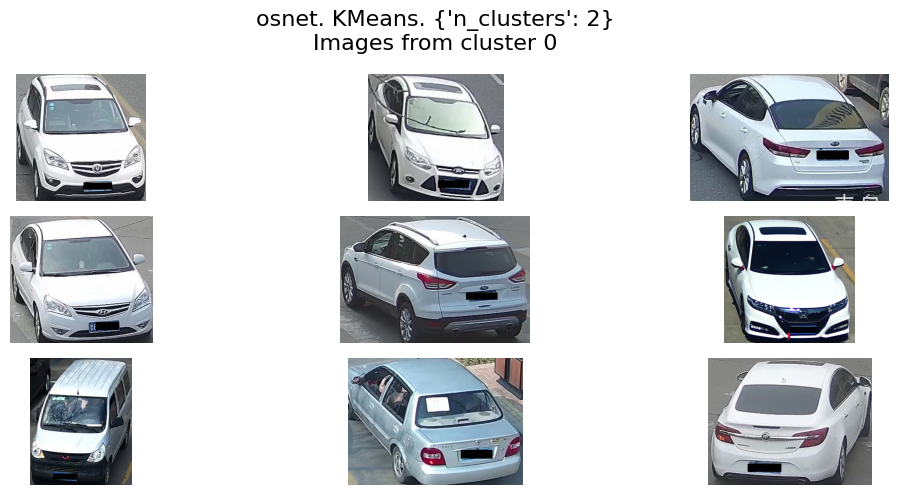

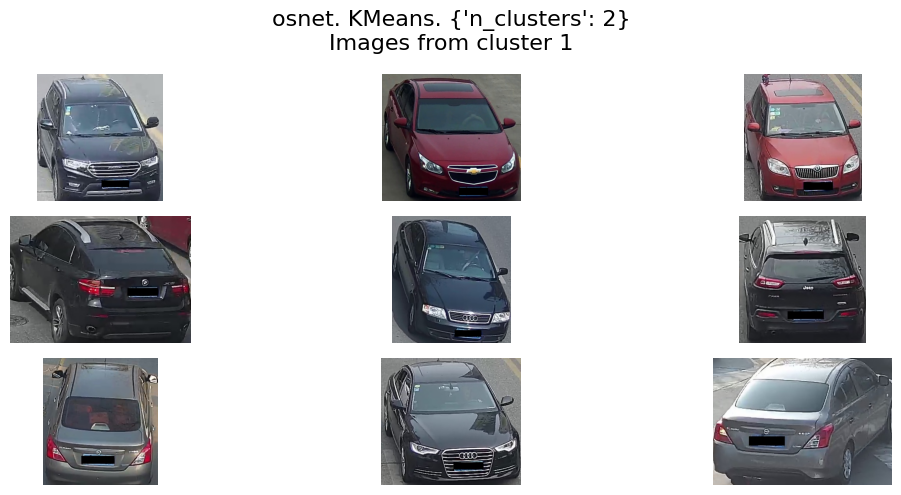

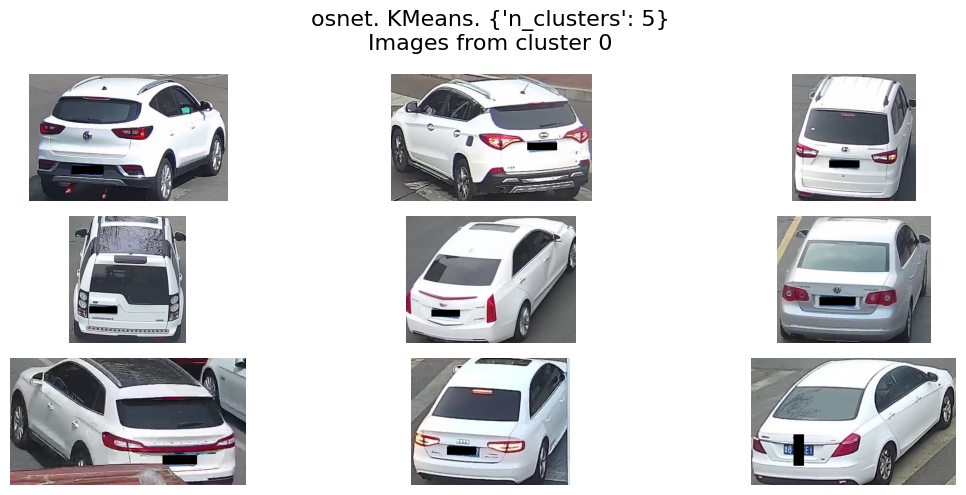

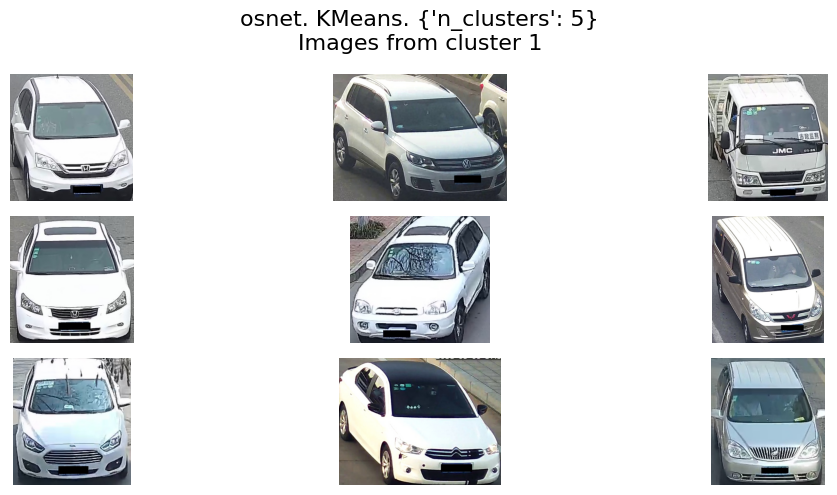

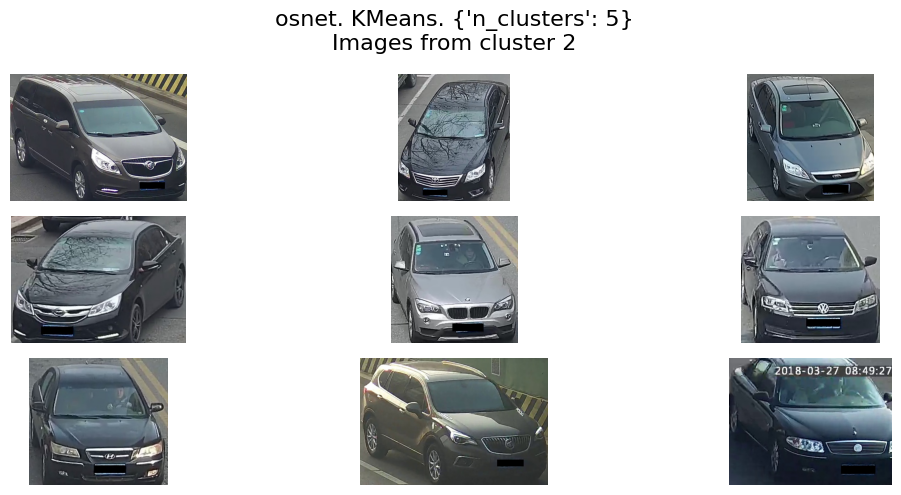

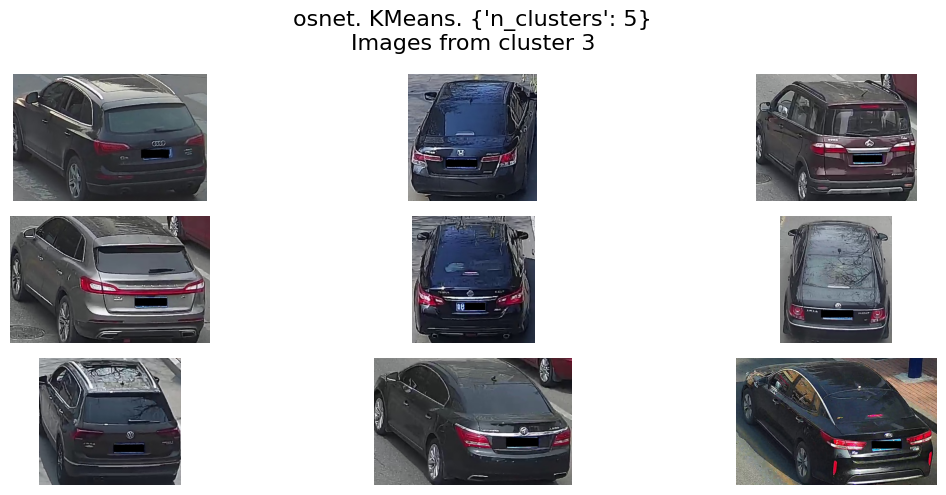

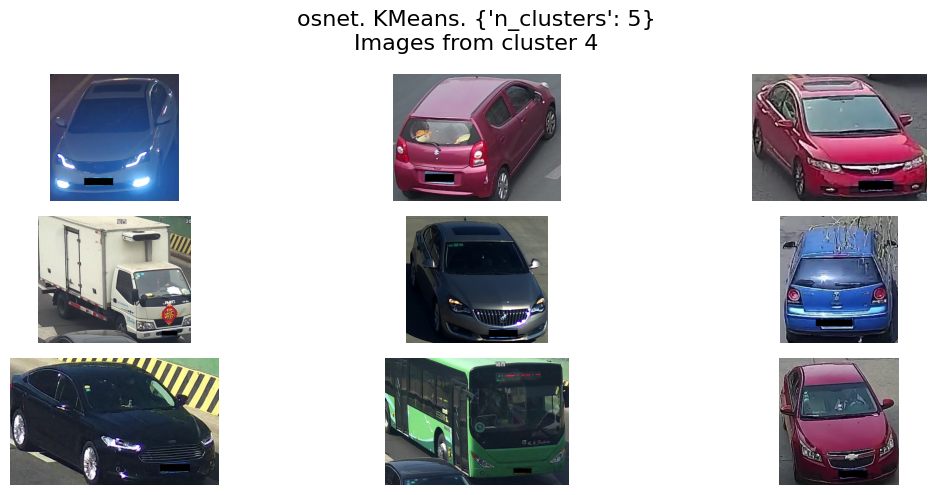

In [9]:
plot_cluster_images(best_models['osnet'])

**osnet**:
- При разбиении на два кластера выделяются светлые машины (0) и тёмные (1)
- При разбиении на три кластера выделяются светлые (0), тёмные (1) и красные (2) [см. полный ноутбук, ссылка в README.md]
- При разбиении на пять кластеров выделяются светлые вид сзади (0), светлые вид спереди (1), тёмные спереди (2), тёмные сзади (3) и прочие, разноцветные (4)

Последний тип разбиения демонстрирует наилучший результат

Перейдём к vdc_color

vdc_color. KMeans. {'n_clusters': 3}
vdc_color. KMeans. {'n_clusters': 7}


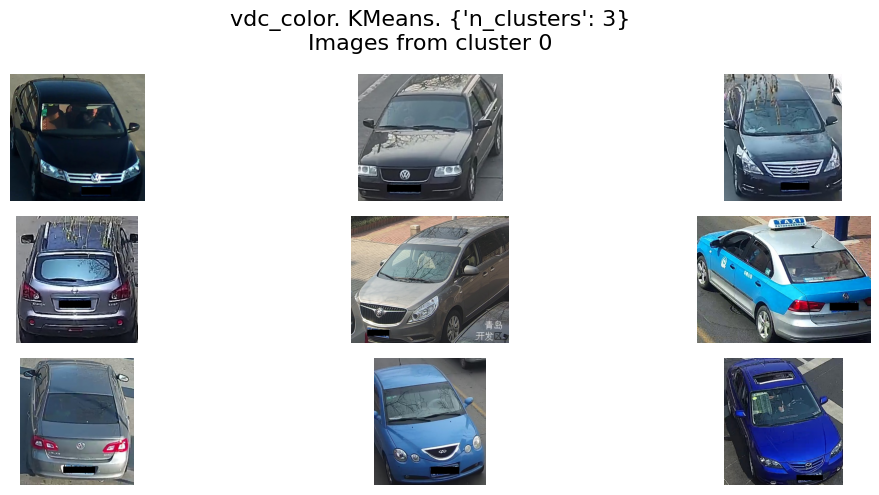

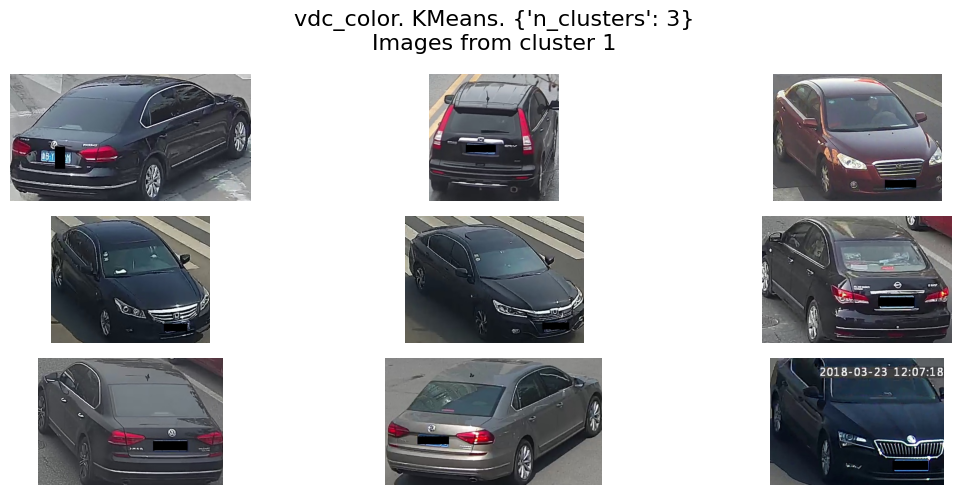

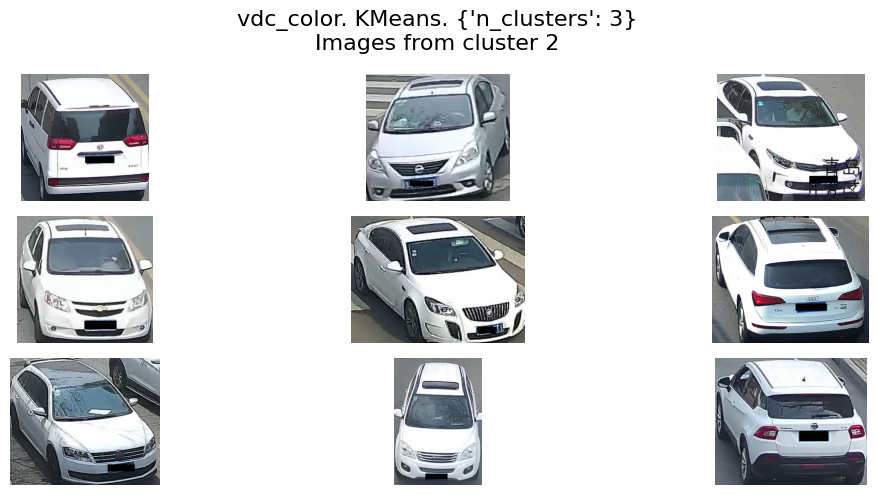

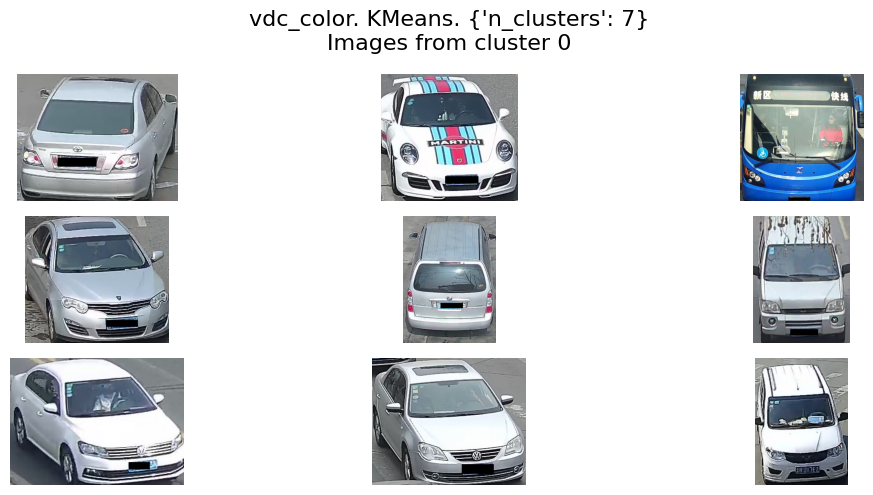

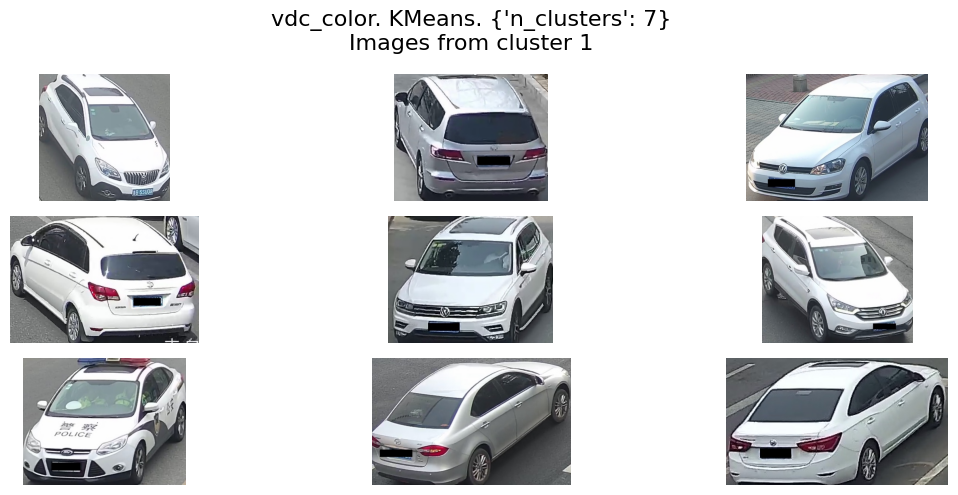

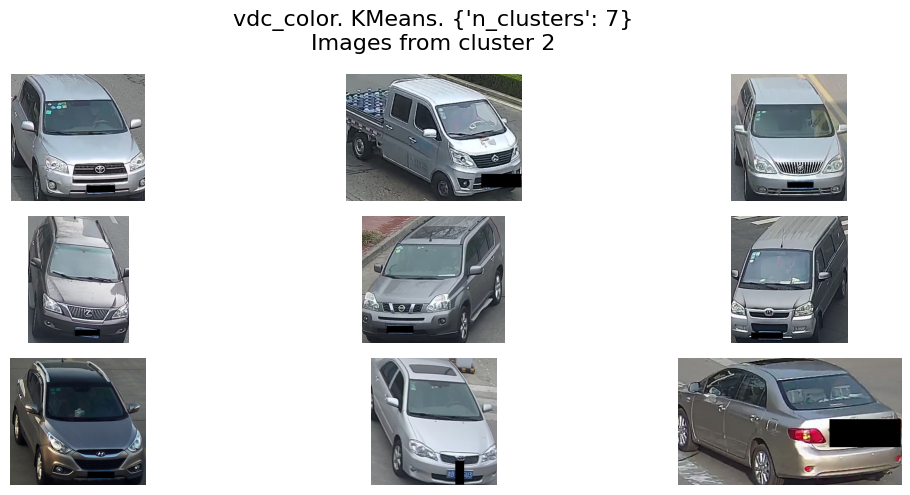

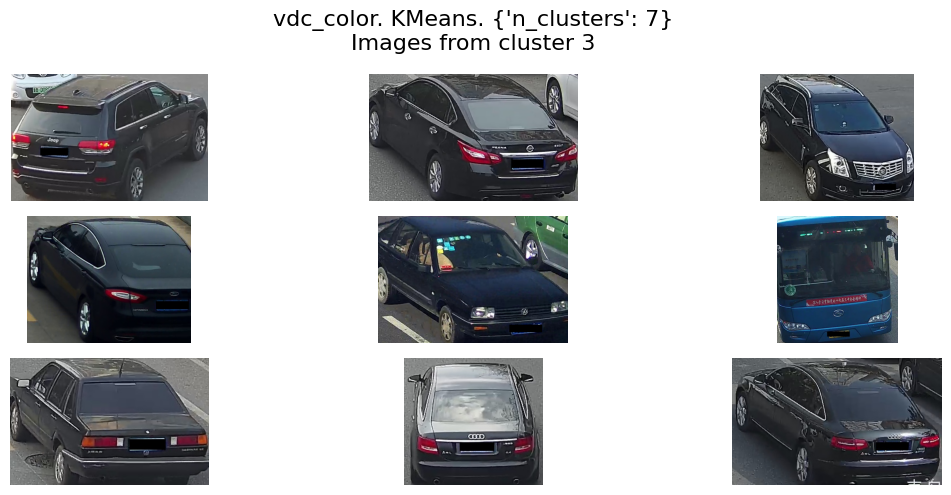

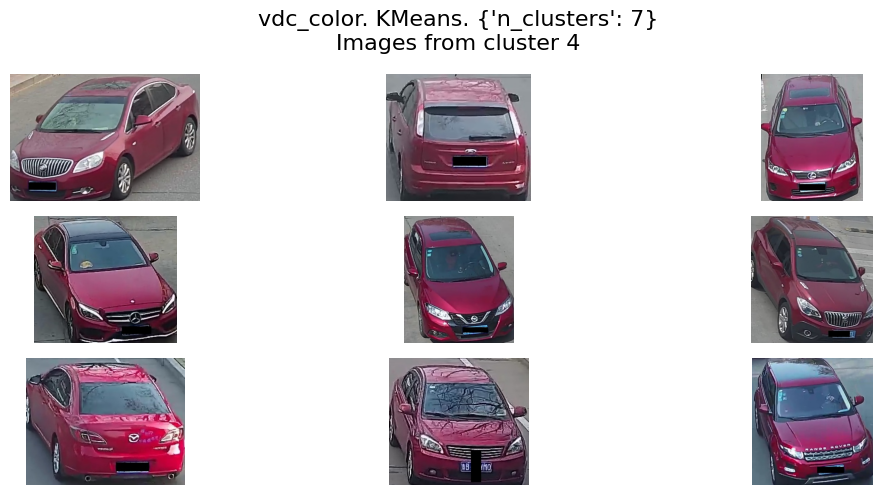

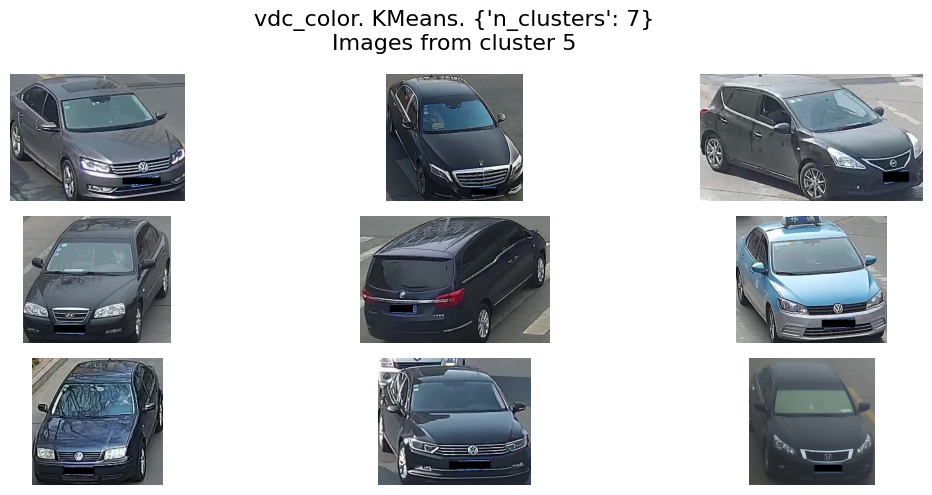

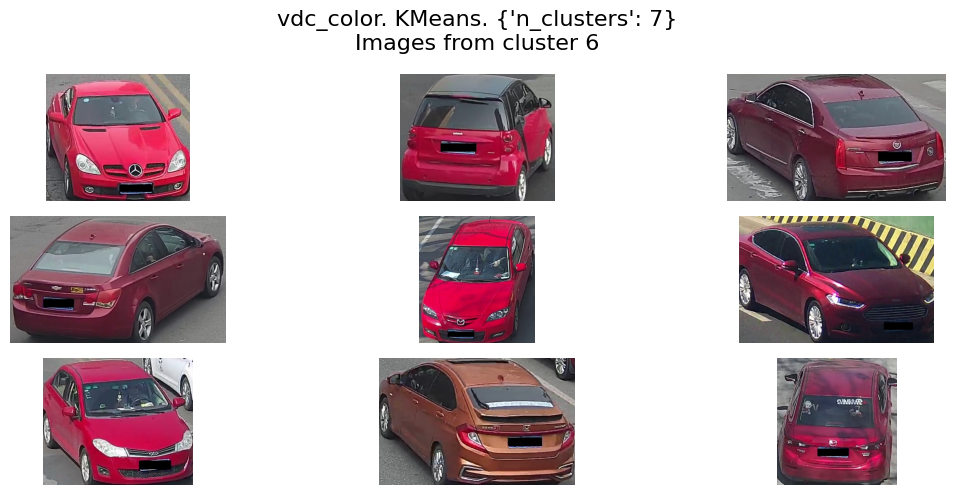

In [10]:
plot_cluster_images(best_models['vdc_color'])

**vdc_color**:
- При разбиении на два кластера выделяются: тёмные (0) и светлые (1) [см. полный ноутбук, ссылка в README.md]
- При разбиении на три кластера: трудно кластеризовать
- При разбиении на пять кластеров выделяются: светлые (серые) (0), тёмные (1), красные (2), белые (3), преимущественно чёрные (4) [см. полный ноутбук, ссылка в README.md]
- **При разбиении на семь кластеров** выделяются: светлые (серые и голубоватые) (0), белые (1), светлые (серые, зеленоватые) (2), тёмно-серые (3), красные (4), тёмные (и синие) (5), красные (более яркие, оранжевые) (6)
- При разбиении на 16 кластеров выделяются: белые, светлые, вид спереди (0), светлые, голубые (1); белые, светлые, вид сзади (2); тёмные, вид сзади (3); красные (4); белые, светлые, вид спереди (5); тёмные, синие, вид спереди (6); белые, светлые, вид спереди (7); тёмные, ближе к чёрным, вид спереди (8); белые, светлые, вид сзади (9); тёмные, вид сзади (10); ближе к светлым (11); белые с зеброй на заднем фоне (12); тёмные (13); зелёные, жёлтые, оранжевые (14); тёмные (15) [см. полный ноутбук, ссылка в README.md]

Наиболее полноценно выглядит модель с семью кластерами.

Рассмотрим vdc_type

vdc_type. KMeans. {'n_clusters': 2}
vdc_type. KMeans. {'n_clusters': 9}


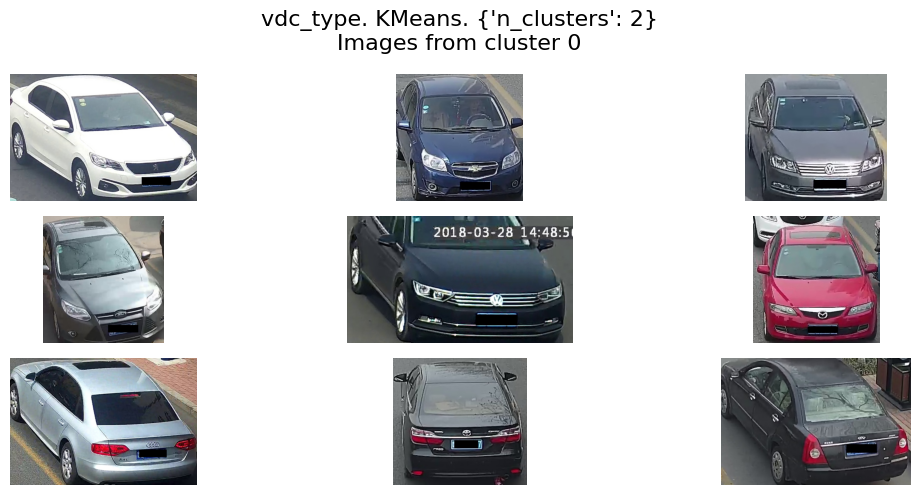

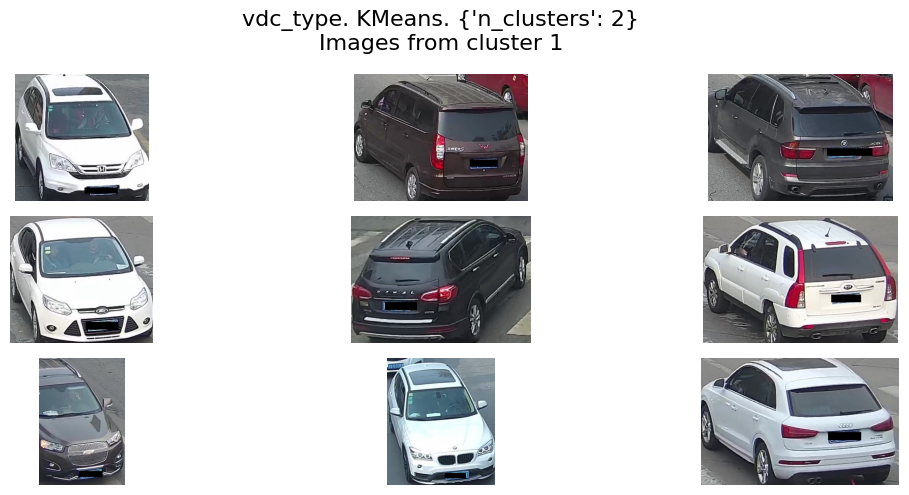

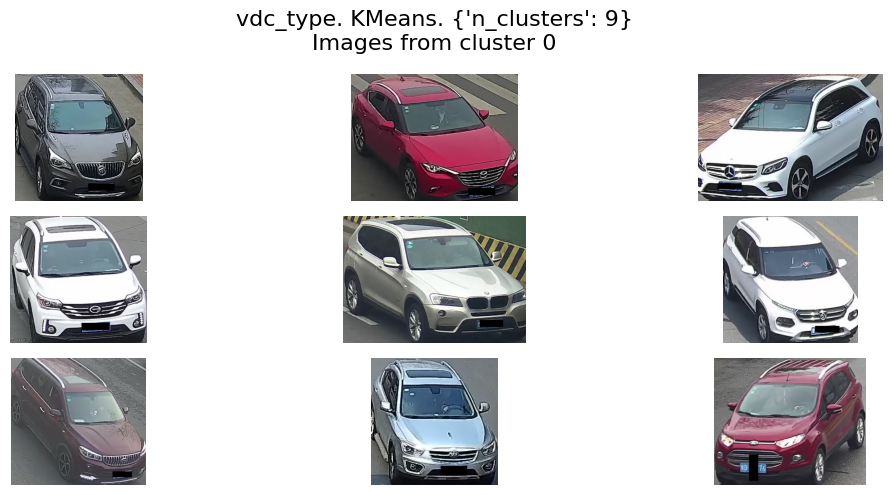

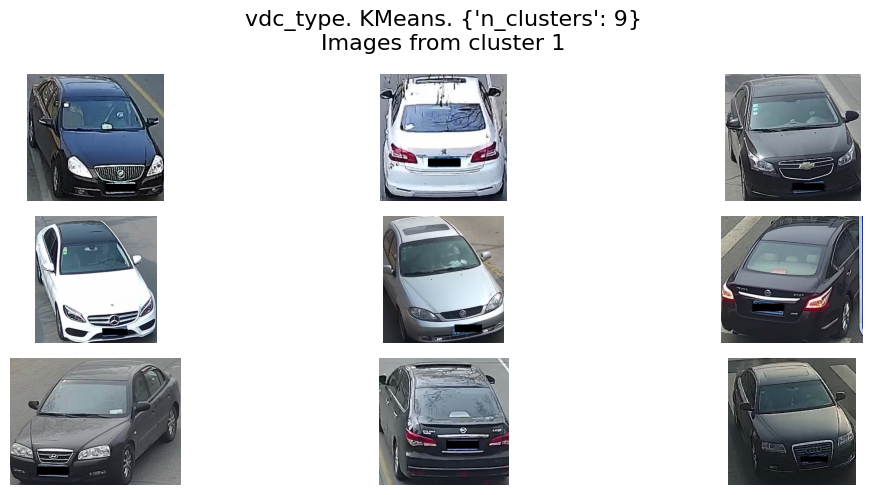

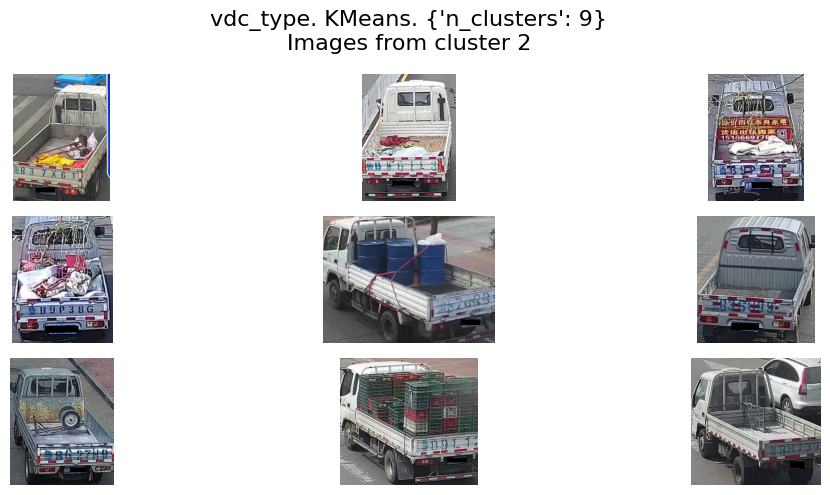

...

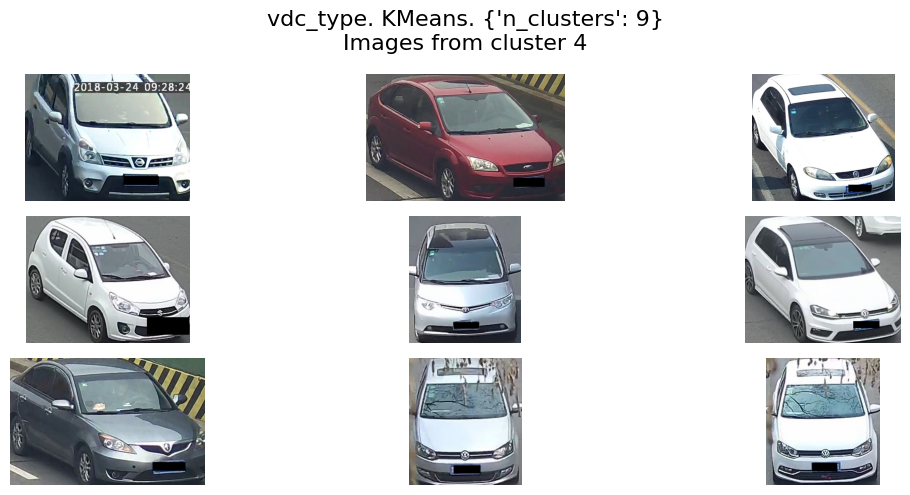

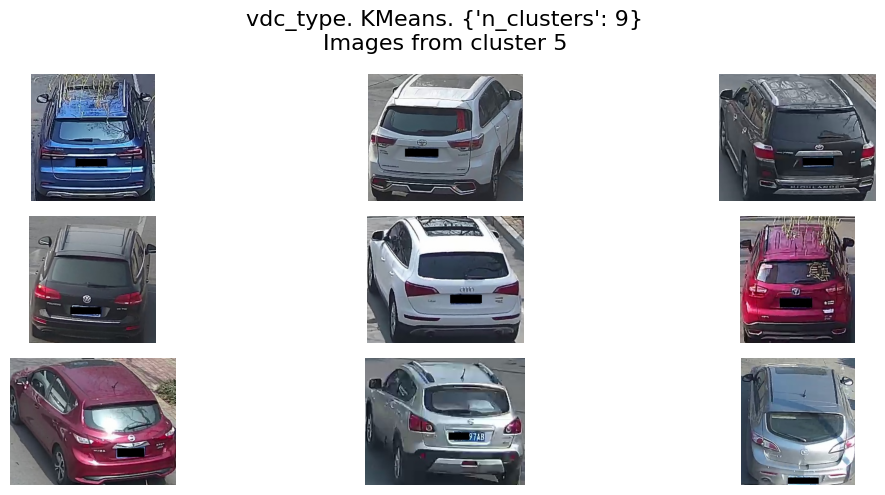

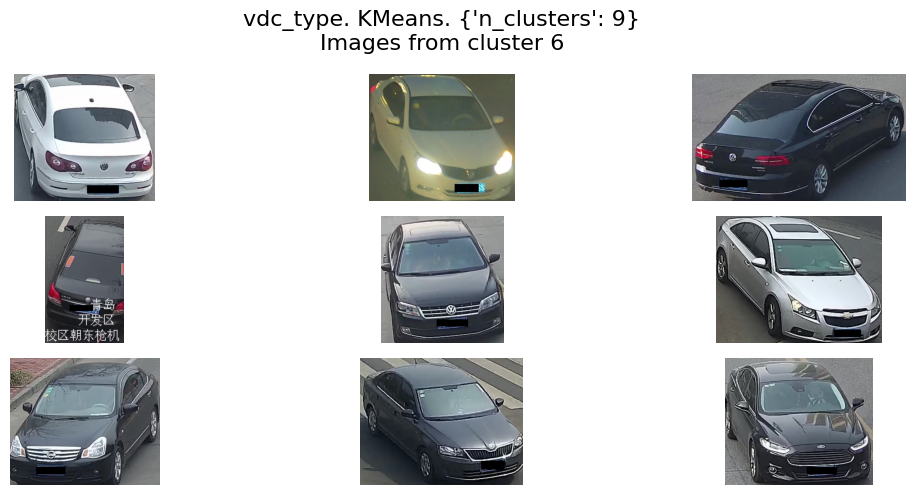

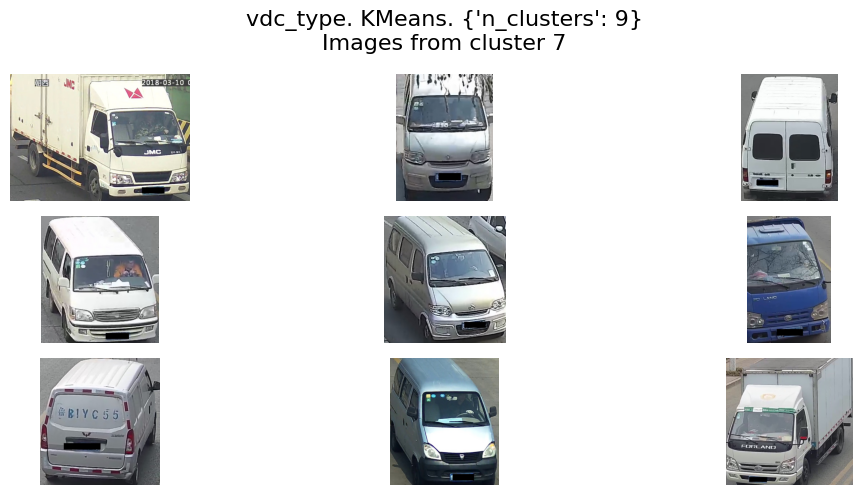

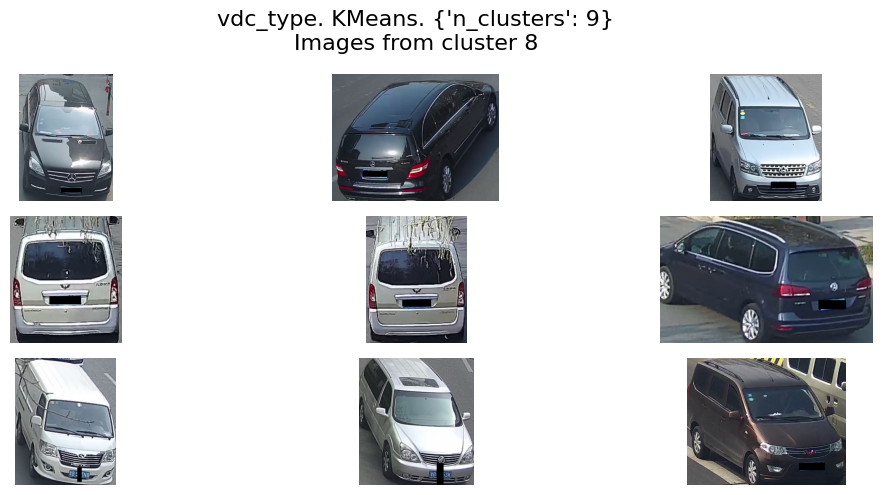

In [11]:
plot_cluster_images(best_models['vdc_type'])

**vdc_type**:
- Разбиение на два кластера: седаны (0); кроссоверы, минивены (1)
- Разбиение на пять кластеров: различные по типу машины(0); седаны(1); кроссоверы (2); седаны (более тёмные) (3); грузовики, пикапы (4) [см. полный ноутбук, ссылка в README.md]
- Разбиение на семь кластеров: светлые седаны (0); тёмные седаны (1); кроссоверы (2); грузовички (с прицепом) (3); седаны вид сзади (4); минивэны (5); высокие машины - минивэны, грузовики, автобусы (6) [см. полный ноутбук, ссылка в README.md];
- **Разбиение на девять кластеров**: кроссоверы (вид спереди) (0); седаны (1); грузовики (2); автобусы (3); седаны (вид спереди) (4); кроссоверы (вид сзади) (5); седаны (6); высокие авто - минивэны, грузовики, автобусы (7); минивэны (8);

Наилучшим образом себя показало разбиение на 9 кластеров.

**Итого, топ две модели по разбиению изображений:**
- vdc_type. KMeans. 9 кластеров - выделяет типы авто.
- vdc_color. KMeans. 7 кластеров - выделяет цвет авто.

### 3.3. Поиск выбросов

С помощью известных вам методов поиска выбросов (например, DBSCAN) попытайтесь найти выбросы среди изображений, используя все варианты дескрипторов. Подберите параметры алгоритма.

Визуализируйте изображения, попавшие в раздел выбросов, и попробуйте проинтерпретировать полученные результаты. Подумайте, почему именно эти изображения попали в выбросы.

Сравните результаты для всех вариантов дескрипторов. Какой вариант дескрипторов даёт наилучшее представление о выбросах?



### Решение

Подбор алгоритмов поиска выбросов и их параметров был произведён ранее. Также, результаты по метрикам, распределению по кластерам, визуализации кластеров представлены ранее, в разделе 3.1. Отберём наилучшие:

In [12]:
best_outliers = {
    # 'efficientnet-b7': [3],
    'osnet': [8, 9], # 7
    'vdc_color': [17, 21], # 19
    'vdc_type': [28, 31], # 33
}

Выбросы в 'efficientnet-b7' ничем не примечательны[см. полный ноутбук, ссылка в README.md].

Сложно выявить различие

Перейдём к osnet:

osnet. DBSCAN. {'eps': 1, 'min_samples': 1024}
osnet. HDBSCAN. {'min_cluster_size': 96}


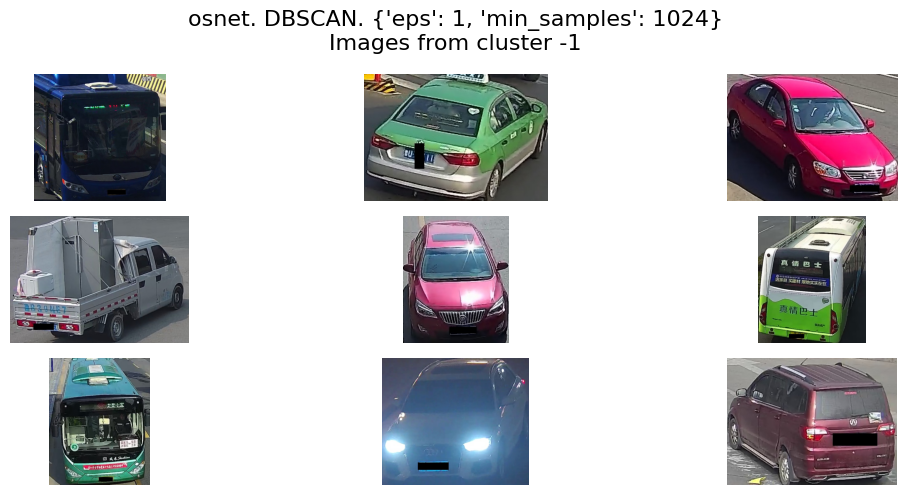

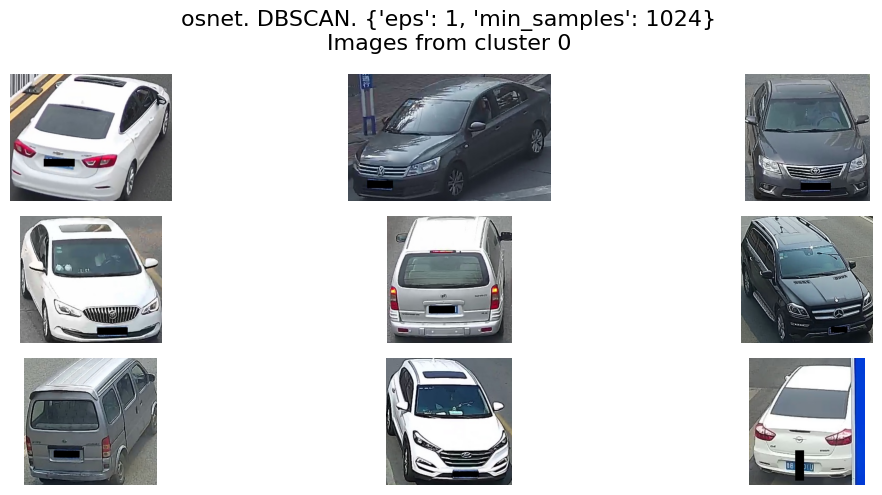

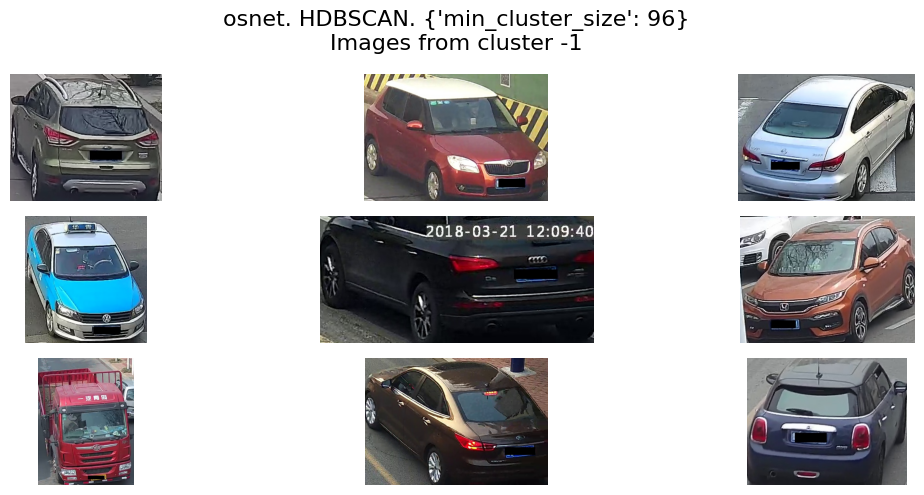

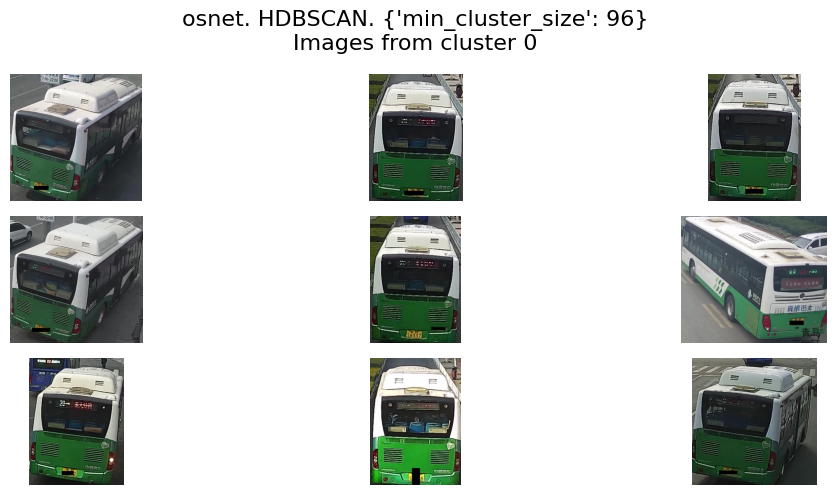

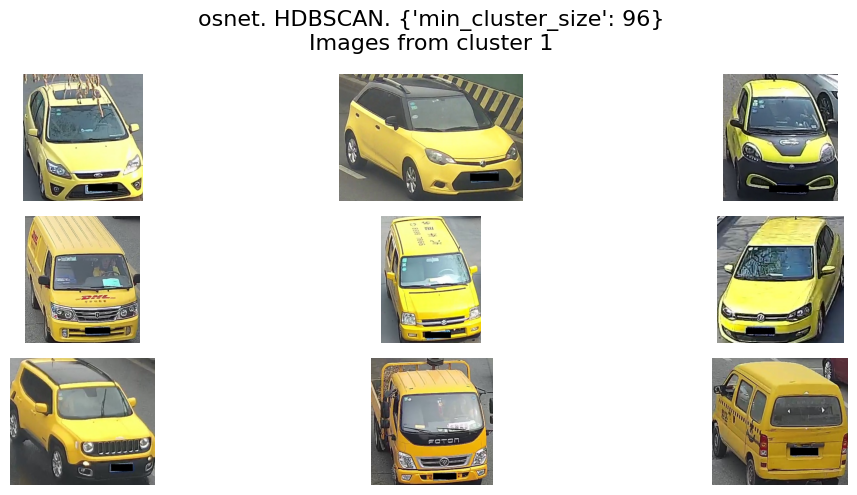

...

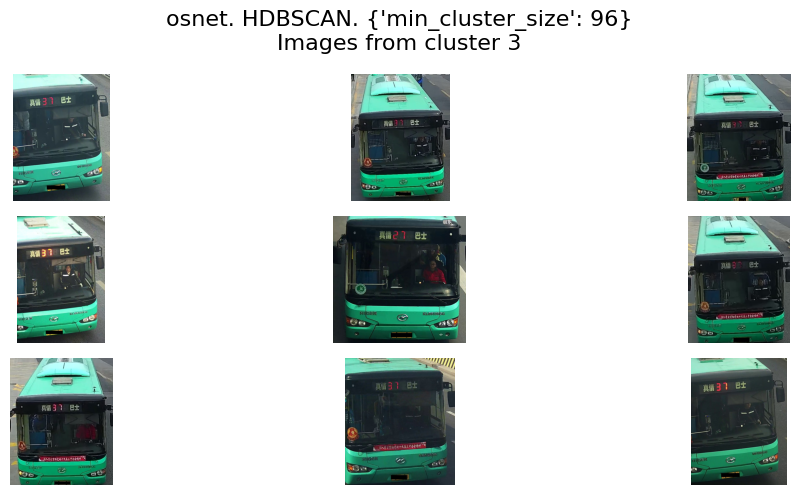

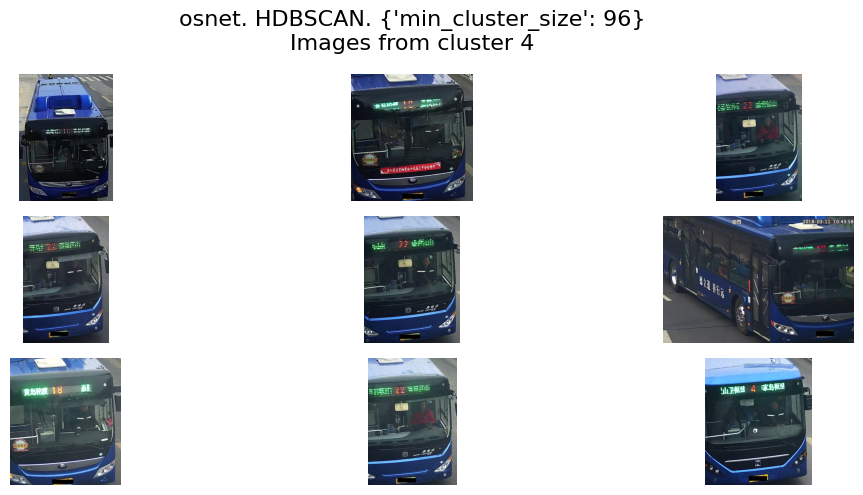

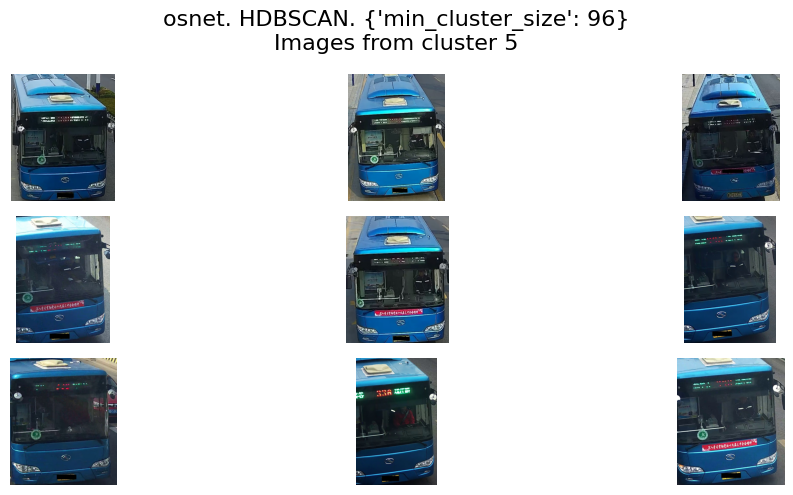

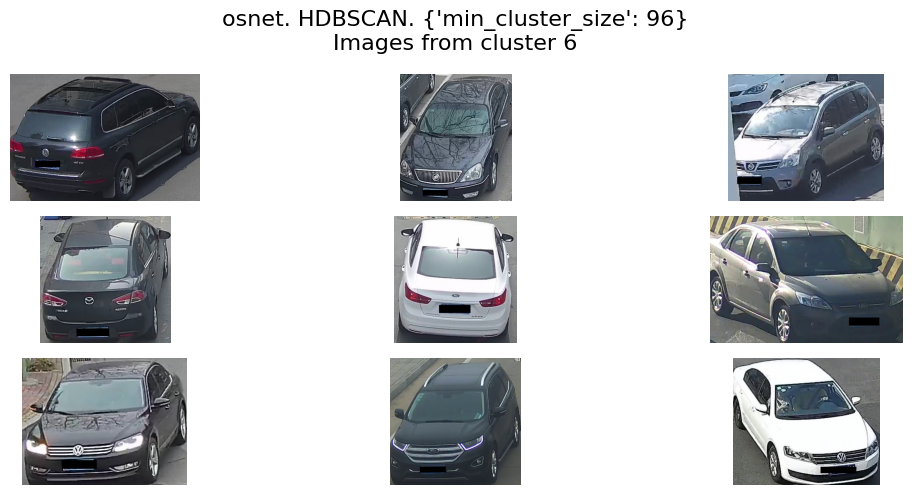

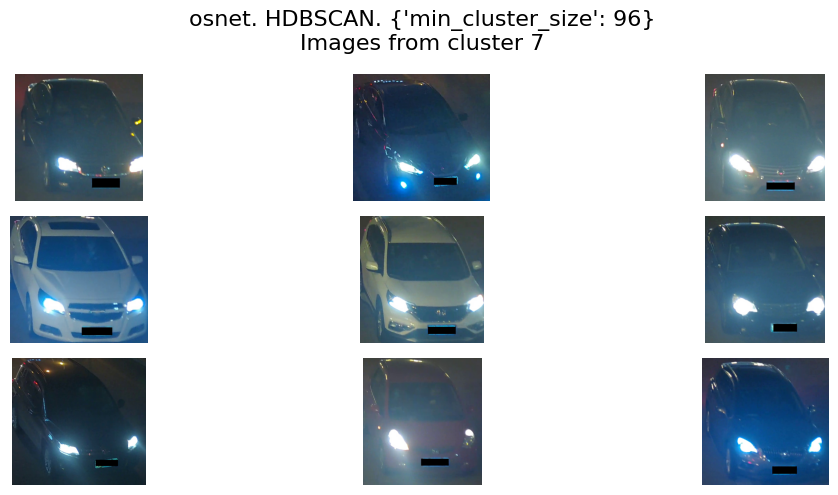

In [13]:
plot_cluster_images(best_outliers['osnet'])

- В выбросы "osnet. DBSCAN. {'eps': 1, 'min_samples': 4096}" попадают как изображения с "дефектами", типа свисающих ветвей, так и изображения, мало отличающиеся от "нормальных".
- В выбросы **"osnet. DBSCAN. {'eps': 1, 'min_samples': 1024}"** попало больше кадров со свисающими ветвями, бликами от деревьев и изображений с надписями - как на самом кадре, так и на машинах. Однако тоже нельзя сказать, что эта модель хорошо выделяет выбросы.
- В выбросы "osnet. HDBSCAN. {'min_cluster_size': 96}" попали изображения различных по цвету и типу машин, а также изображения с ветвями. Однако остальные кластеры получились узкопрофильными: Вид сзади на бело-зелёные автобусы (0), жёлтые машины (1), вид сзади на бело-салатовые автобусы (2), вид спереди на салатовые автобусы (3), вид спереди на синие автобусы (4), вид спереди на светло-синие автобусы (5), различные седаны и кроссоверы (6), машины в тёмное время суток (7)

Таким образом, лучше всего в данном дескрипторе выделяет выбросы модель "osnet. DBSCAN. {'eps': 1, 'min_samples': 1024}". Однако там много обычных изображений авто.

vdc_color. DBSCAN. {'eps': 1, 'min_samples': 4096}
vdc_color. HDBSCAN. {'min_cluster_size': 32}


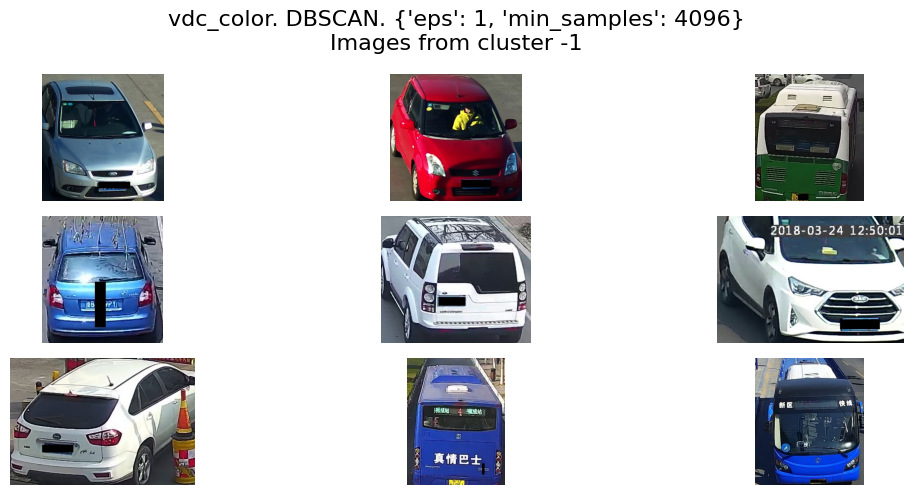

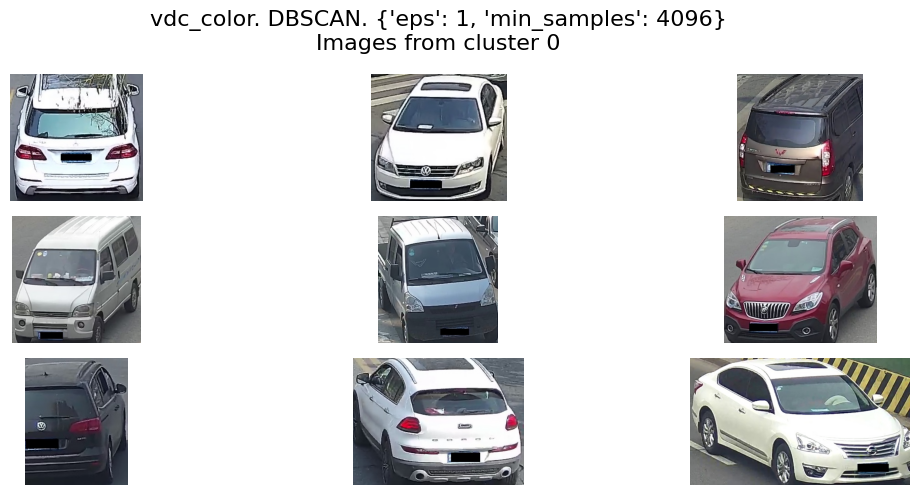

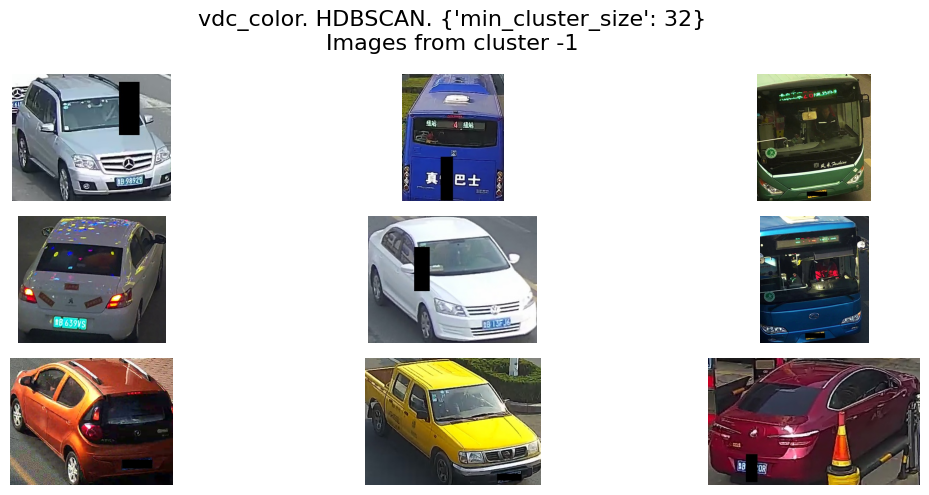

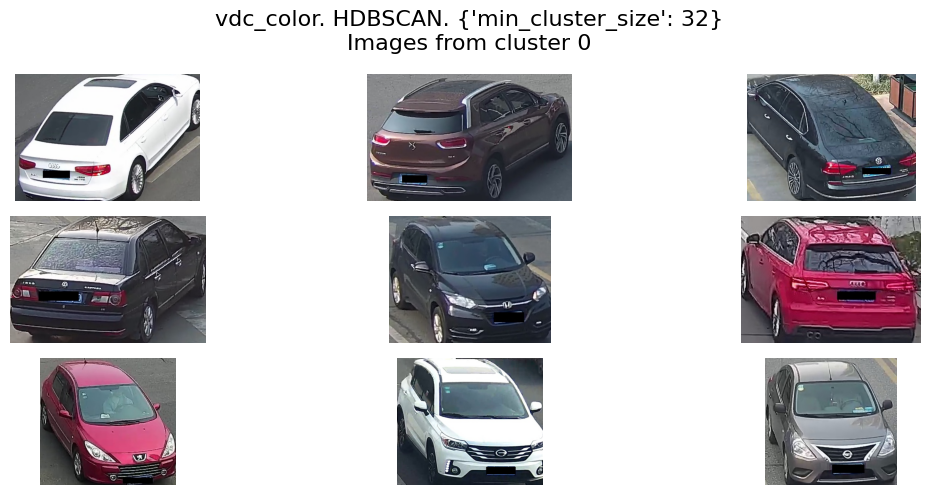

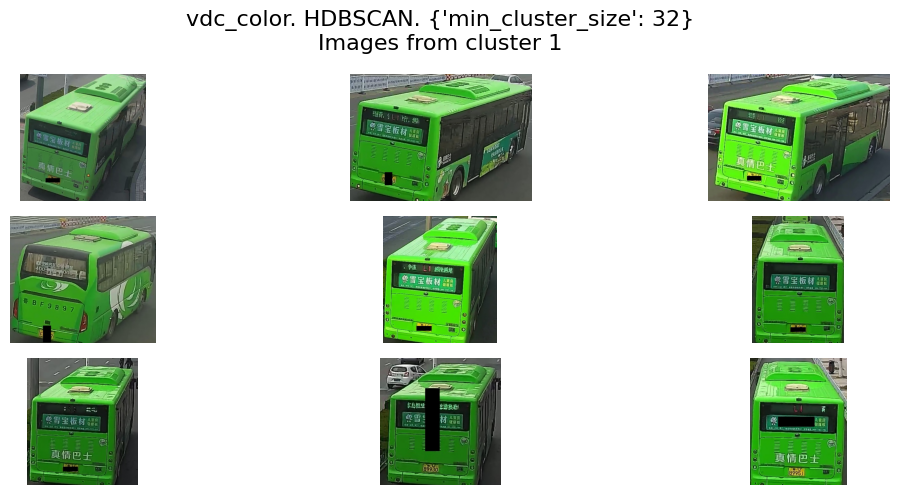

In [14]:
plot_cluster_images(best_outliers['vdc_color'])

- В выбросы "vdc_color. DBSCAN. {'eps': 1, 'min_samples': 4096}" попали наиболее яркие и нетипичные машины, тогда как в основной кластер в основном - серые машины.
- В выбросы "vdc_color. DBSCAN. {'eps': 1, 'min_samples': 256}" также попадают в основном цветные автомобили, тогда как в основной кластер в основном - серые машины.
- В выбросы "vdc_color. HDBSCAN. {'min_cluster_size': 32}" попадали машины с "цветовым" нагромождением - яркие, с надписями, с некоторым содержимым в прицепах. Кластер 0 - серые машины, Кластер 1 - зелёные автобусы, вид сзади.

Здесь также сложно говорить о качественном извлечении выбросов.

vdc_type. DBSCAN. {'eps': 1, 'min_samples': 2048}
vdc_type. HDBSCAN. {'min_cluster_size': 12}


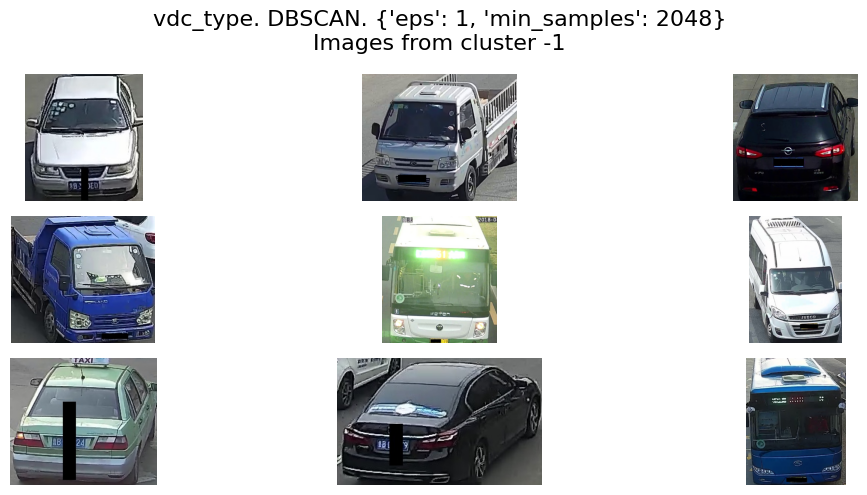

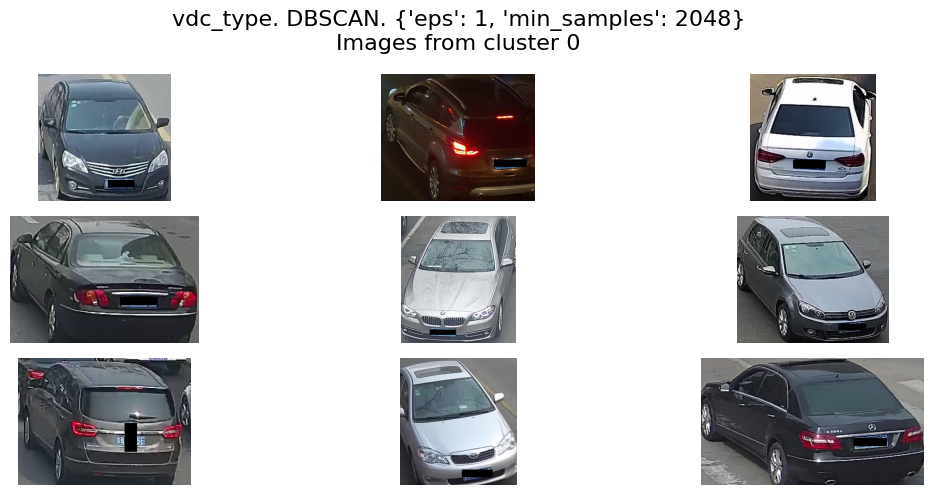

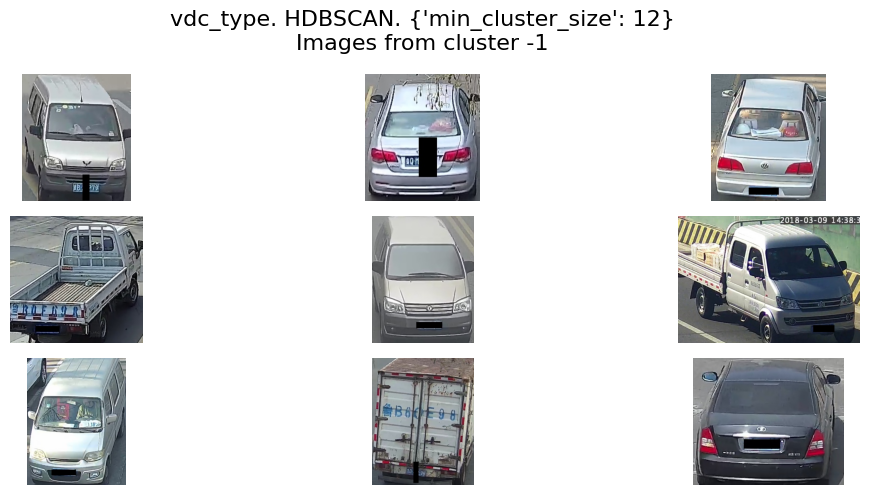

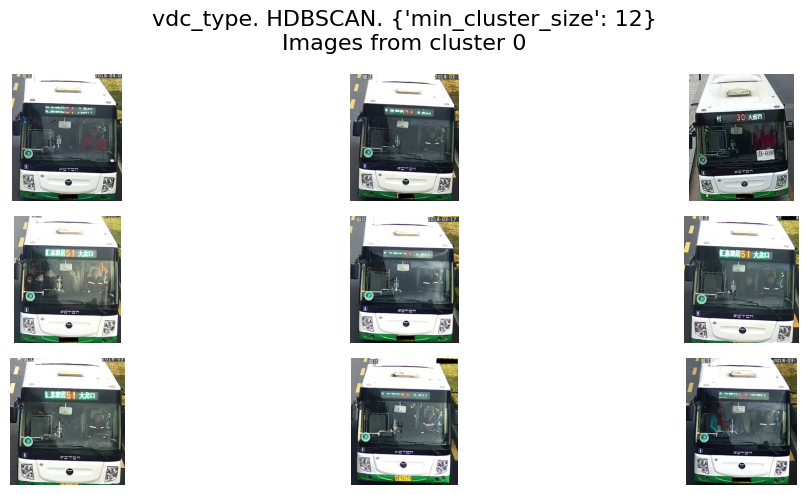

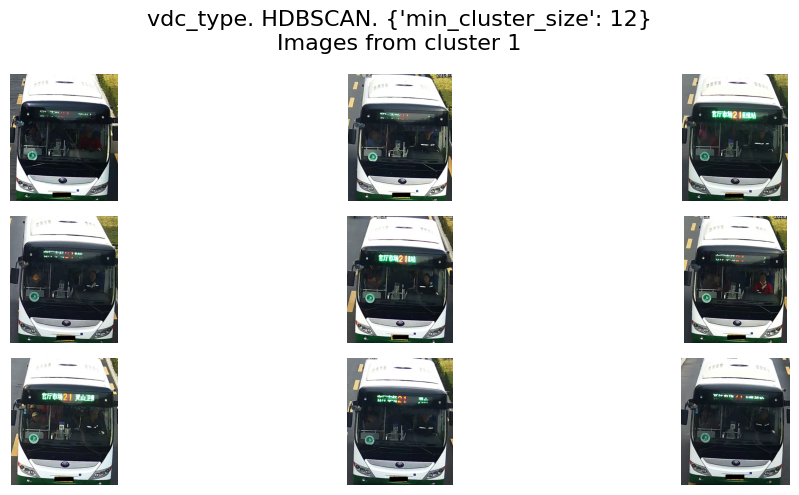

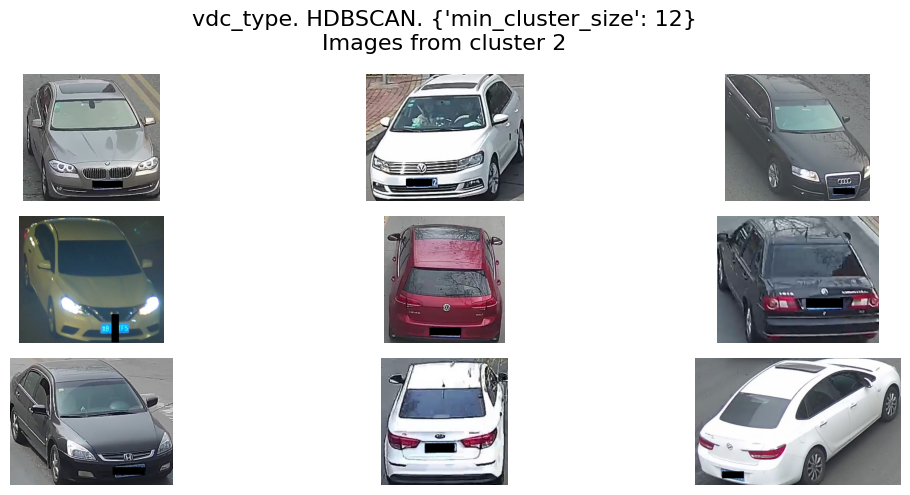

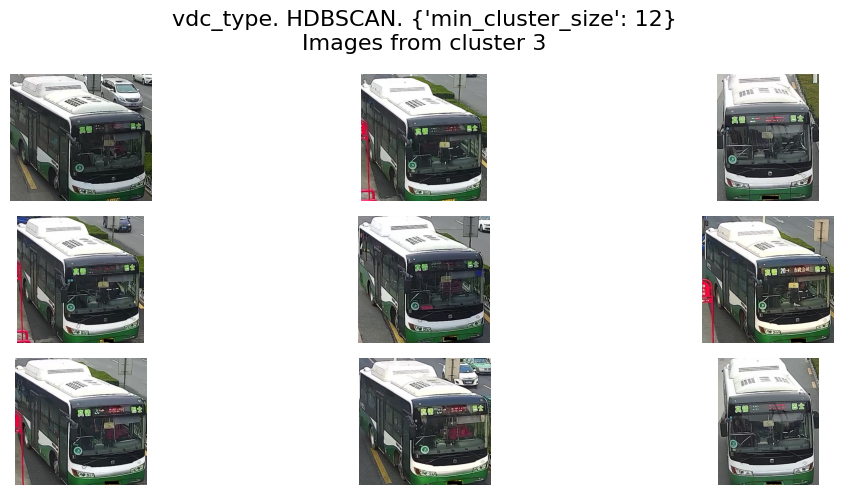

In [15]:
plot_cluster_images(best_outliers['vdc_type'])

- В выбросы "vdc_type. DBSCAN. {'eps': 1, 'min_samples': 2048}" попали машины с большим количеством детализаций, типа надписей, содержимого багажников и так далее, а также изображения с бликами на авто.
- В выбросы "vdc_type. HDBSCAN. {'min_cluster_size': 24}" также попадают изображения с бликами от деревьев, изображения с ветвями, с большим количеством надписей. В кластер 0 попали автобусы (белые), а в кластер 1 различные авто (но есть изображения с ветвями деревьев).
- В выбросы "vdc_type. HDBSCAN. {'min_cluster_size': 12}" попали изображения с ветвями, бликами от деревьев, изображения с надписями, засветкой, с различным сожержимом прицепа и так далее. Кластер 0 - белые автобусы, Кластер 1 - автобусы другого типа, Кластер 2 - Различные авто (имеются и с ветвями), Кластер 3 - ещё автобусы.

Таким образом тоже сложно выделить какую-то модель, эффективно борющуюся с действительными выбросами.

#### Выводы по выбросам:

Таким образом, эффективной обработки выбросов добиться не удалось. Наилучишм образом из всех моделей показала себя **"osnet. DBSCAN. {'eps': 1, 'min_samples': 1024}"**. В кластер выбросов попало больше кадров со свисающими ветвями, бликами от деревьев и изображений с надписями - как на самом кадре, так и на машинах.

При необходимости, возможно более глубокое исследование моделей для поиска выбросов с подбором параметров таким образом, чтобы больше всего попадало кадров с действительно "дефектными" изображениями.

## 4. Выводы и оформление проекта

На основе результатов, полученных при выполнении проекта, сделайте вывод по задаче, приведя таблицу со сравнением результатов кластеризации на каждом из наборов дескрипторов. Приведите сравнение вариантов предобработки исходных данных по качеству кластеризации.

Результатом вашей работы должно стать небольшое исследование, в котором вы даёте команде IntelliVision рекомендации, какие дескрипторы, с какой предобработкой и каким алгоритмом кластеризации лучше всего подходят для решения задачи.

Также сохраните результаты лучшего алгоритма в CSV-файл со столбцами path (путь до изображения) и cluster (номер кластера). В описании к проекту приведите расшифровку каждого из кластеров.

Когда вы закончите выполнять проект, создайте в своём репозитории файл README.md и кратко опишите содержание проекта по принципу, который мы приводили ранее.

Выложите свой проект на GitHub и оформите удалённый репозиторий, добавив в него описание и теги (придумайте их самостоятельно в зависимости от того, какую задачу вы решали).

## Резюмируем

Проводилась кластеризация 416314 изображений с камер по их четырём дескрипторам.

**Снижение размерности.** Для снижения размерности применялся метод главных компонент (PCA), причём количество признаков определялось "объясняемым" разбросом таким образом, чтобы значение было больше 60%. 

**Масштабирование**. Проведённый в разделе 3.1. сравнительный анализ качества методов масштабирования для всех дескрипторов и моделей типа KMeans, DBSCAN и HDBSCAN показал, что наивысшие значения индекса Калински-Харабаса и наименьшие значения индекса Дэвиса-Болдина достигаются при Нормализации (**MinMaxScaler**). Именно этот метод масштабирования и использовался в последствии.

### Лучшие модели по дескрипторам

По максимальному значению индекса Калински-Харабаса и минимальному по индексу Дэвиса-Болдина, можно выделить следующие модели в зависимости от дескриптора:

In [16]:
display_models(cluster_results_df, head_rows=5)

ДЕСКРИПТОР: efficientnet-b7


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
2,KMeans,{'n_clusters': 8},8,870.849624,8.571263
0,KMeans,{'n_clusters': 6},6,786.321168,9.153721
1,KMeans,{'n_clusters': 4},4,657.244097,7.653161
3,DBSCAN,"{'eps': 2, 'min_samples': 256}",2,251.980365,10.569928


ДЕСКРИПТОР: osnet


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
4,KMeans,{'n_clusters': 2},2,18166.923245,4.636694
5,KMeans,{'n_clusters': 3},3,12546.612016,4.261832
6,KMeans,{'n_clusters': 5},5,9758.297601,4.866780
9,HDBSCAN,{'min_cluster_size': 96},9,1106.080032,3.436839
10,HDBSCAN,{'min_cluster_size': 64},16,864.263185,2.689393


ДЕСКРИПТОР: vdc_color


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
12,KMeans,{'n_clusters': 2},2,18384.377761,4.684858
13,KMeans,{'n_clusters': 3},3,11343.469499,6.155261
14,KMeans,{'n_clusters': 5},5,7572.683884,6.194284
15,KMeans,{'n_clusters': 7},7,5941.520426,5.557620
16,KMeans,{'n_clusters': 16},16,3692.900308,5.010982


ДЕСКРИПТОР: vdc_type


,cluster_class,cluster_class_params,n_clusters,calinski_harabasz_score,davies_bouldin_score
23,KMeans,{'n_clusters': 2},2,9598.536960,6.437812
24,KMeans,{'n_clusters': 3},3,6377.632071,6.832862
25,KMeans,{'n_clusters': 5},5,4358.785085,6.555854
26,KMeans,{'n_clusters': 7},7,3857.971057,5.914642
27,KMeans,{'n_clusters': 9},9,3423.689906,5.438414


При этом наилучшие показатели достигаются у дескрипторов "vdc_color" и "osnet"

При визуализации кластеров наихудшим образом себя продемонстрировал дескриптор "efficient-b7". 

Наилучшим образом показали себя дескрипторы "vdc_color" и "vdc_type", кластеризованные моделью KMeans с числом кластеров 7.

При обработке выбросов не удалось достигнуть качественного результата, при необходимости, возможно более глубокое исследование. На текущий момент наилучшая из имеющихся модель **"osnet. DBSCAN. {'eps': 1, 'min_samples': 1024}"**. В кластер выбросов попало больше кадров со свисающими ветвями, бликами от деревьев и изображений с надписями - как на самом кадре, так и на машинах.

**В итоге**, по интерпретации изображений, попавших в кластеры, были выделены две модели:
- vdc_type. KMeans. 9 кластеров - выделяет типы авто.
- vdc_color. KMeans. 7 кластеров - выделяет цвет авто.

Причём первая из них более информативна. Сохраним её.

In [17]:
display(cluster_results_df.iloc[27])
best_model = get_model_dataframe(
    model_idx=27,
    cluster_df=cluster_results_df
)
display(best_model.head())
best_model.to_csv('results/best_clusterization.csv')

descriptor                                                          vdc_type
scaler                                                                  norm
cluster_class                                                         KMeans
cluster_class_params                                       {'n_clusters': 9}
labels                     [0, 0, 5, 0, 5, 0, 8, 8, 8, 8, 8, 6, 1, 1, 6, ...
n_clusters                                                                 9
calinski_harabasz_score                                          3423.689906
davies_bouldin_score                                                5.438414
Name: 27, dtype: object

,paths,cluster
0,data/raw_data/veriwild/1/00001/000001.jpg,0
1,data/raw_data/veriwild/1/00001/000002.jpg,0
2,data/raw_data/veriwild/1/00001/000003.jpg,5
3,data/raw_data/veriwild/1/00001/000004.jpg,0
4,data/raw_data/veriwild/1/00001/000005.jpg,5


Метки модели vdc_color (см. изображения в results/vdc_color_cluster_#.png):

0. светлые (серые и голубоватые) 
1. белые
2. светлые (серые, зеленоватые)
3. тёмно-серые
4. красные 
5. тёмные (и синие) 
6. красные (более яркие, оранжевые)

Сохранённая модель имеет следующие метки:

0. кроссоверы (вид спереди)
1. седаны
2. грузовики
3. автобусы
4. седаны (вид спереди)
5. кроссоверы (вид сзади)
6. седаны
7. высокие авто - минивэны, грузовики автобусы
8. минивэны